[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/aurelio-labs/semantic-router/blob/main/docs/07-multi-modal.ipynb) [![Open nbviewer](https://raw.githubusercontent.com/pinecone-io/examples/master/assets/nbviewer-shield.svg)](https://nbviewer.org/github/aurelio-labs/semantic-router/blob/main/docs/07-multi-modal.ipynb)

# Multi-Modal Routes

The Semantic Router library can also be used for detection of specific images or videos, for example the detection of **N**ot **S**hrek **F**or **W**ork (NSFW) and **S**hrek **F**or **W**ork (SFW) images as we will demonstrate in this walkthrough.

## Getting Started

We start by installing the library:

In [1]:
!pip install -qU \
    "semantic-router[vision]" \
    datasets==2.17.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.9/55.9 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 536.6/536.6 kB 18.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 34.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.0/52.0 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 227.4/227.4 kB 22.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 65.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 79.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 80.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 15.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 16.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 67.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.0/75.0 kB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━

We start by downloading a multi-modal dataset, we'll be using the `aurelio-ai/shrek-detection` dataset from Hugging Face.

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Generating train split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

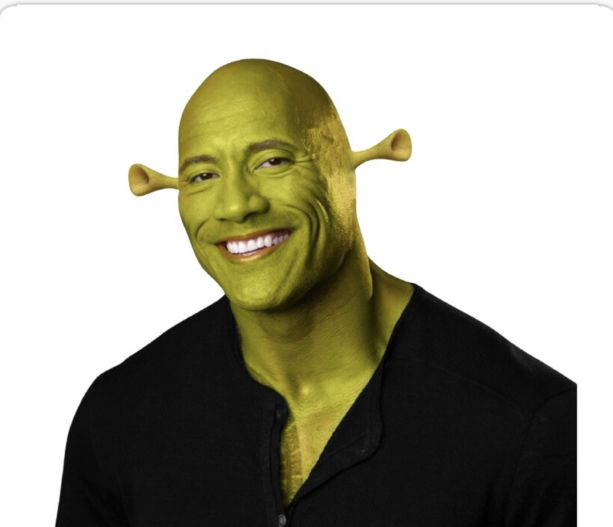

In [2]:
from datasets import load_dataset

data = load_dataset("aurelio-ai/shrek-detection", split="train", trust_remote_code=True)
data[3]["image"]

We will grab the images that are labeled with `is_shrek`:

In [3]:
shrek_pics = [d["image"] for d in data if d["is_shrek"]]
not_shrek_pics = [d["image"] for d in data if not d["is_shrek"]]
print(f"We have {len(shrek_pics)} shrek pics, and {len(not_shrek_pics)} not shrek pics")

We have 5 shrek pics, and 19 not shrek pics


We start by defining a dictionary mapping routes to example phrases that should trigger those routes.

In [4]:
from semantic_router import Route

shrek = Route(
    name="shrek",
    utterances=shrek_pics,
)

Let's define another for good measure:

In [5]:
not_shrek = Route(
    name="not_shrek",
    utterances=not_shrek_pics,
)

routes = [shrek, not_shrek]

Now we initialize our embedding model:

In [6]:
from semantic_router.encoders.clip import CLIPEncoder

encoder = CLIPEncoder()

tokenizer_config.json:   0%|          | 0.00/905 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/961k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.10k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/599M [00:00<?, ?B/s]

Now we define the `RouteLayer`. When called, the route layer will consume text (a query) and output the category (`Route`) it belongs to — to initialize a `RouteLayer` we need our `encoder` model and a list of `routes`.

In [7]:
from semantic_router.layer import RouteLayer

rl = RouteLayer(encoder=encoder, routes=routes)

2024-03-03 23:35:09 INFO semantic_router.utils.logger local


Now we can test it with _text_ to see if we hit the routes that we defined with images:

In [8]:
rl("don't you love politics?")

RouteChoice(name=None, function_call=None, similarity_score=None, trigger=None)

In [9]:
rl("shrek")

RouteChoice(name='shrek', function_call=None, similarity_score=None, trigger=None)

In [10]:
rl("dwayne the rock johnson")

RouteChoice(name='not_shrek', function_call=None, similarity_score=None, trigger=None)

Everything is being classified accurately, let's pull in some images that we haven't seen before and see if we can classify them as NSFW or SFW.

In [11]:
test_data = load_dataset(
    "aurelio-ai/shrek-detection", split="test", trust_remote_code=True
)
test_data

Dataset({
    features: ['text', 'image', 'is_shrek'],
    num_rows: 11
})

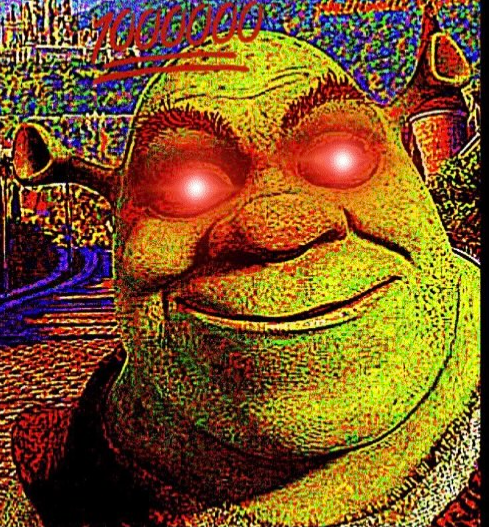

In [14]:
test_data[0]["image"]

In [15]:
rl(test_data[0]["image"]).name

'shrek'

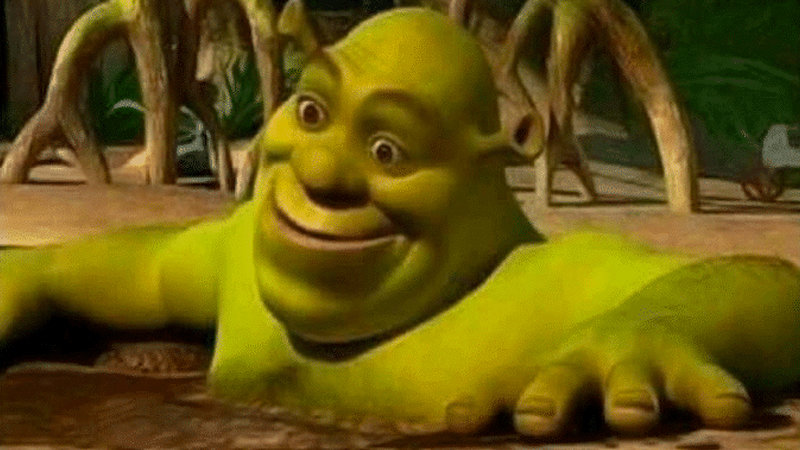

In [16]:
test_data[1]["image"]

In [17]:
rl(test_data[1]["image"]).name

'shrek'

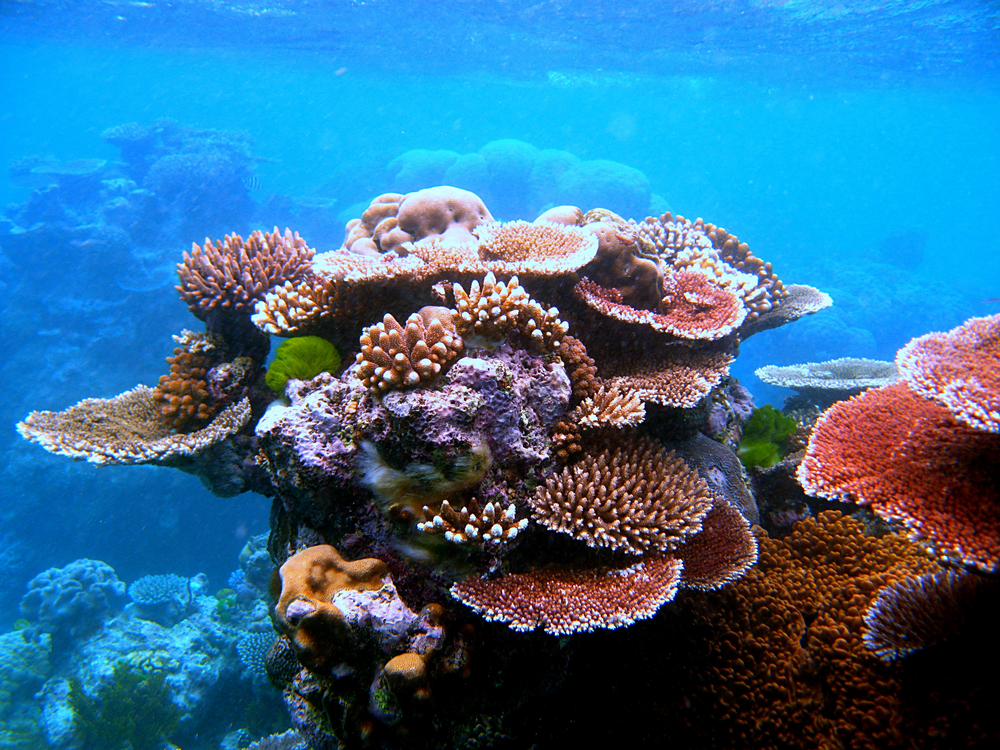

In [18]:
test_data[2]["image"]

In [19]:
rl(test_data[2]["image"]).name

'not_shrek'

These all look great, we've managed to accurately classify these images using our relatively small route space.

Taking this further, we can easily use [route optimization](https://github.com/aurelio-labs/semantic-router/blob/main/docs/06-threshold-optimization.ipynb), the addition of more utterances, or more routes to improve performance further when and where required.

---